In [ ]:
quiet_library <- function(...) {
    suppressPackageStartupMessages(library(...))
}
quiet_library(Seurat)
quiet_library(ggplot2)
quiet_library(Matrix)
quiet_library(H5weaver)
quiet_library(dplyr)
quiet_library(viridis)
quiet_library(harmony)
quiet_library(Nebulosa)

# Figure 1a

In [2]:
sp_merge <- readRDS(file = '/home/jupyter/Organized_Gating_Analysis/Seurat_Objects/sp_merge_gating_celltype_updated.rds')

In [3]:
split_sp_merge <- SplitObject(sp_merge, split.by = 'pediatric_senior')

In [6]:
celltypes <- unique(sp_merge$gating_celltype)
celltypes

[1] "CD8 Naive" "CD8 CM"    "CD8 EM1"   "CD8 EM2"   "CD8 TEMRA" "CD8 Unk"  
 [7] "CD4 Naive" "CD4 CM"    "CD4 EM1"   "CD4 EM2"   "CD4 TEMRA" "Treg"     
[13] "CD4 Unk"

In [12]:
trim_celltypes <- celltypes[-c(6,13)]
trim_celltypes

[1] "CD8 Naive" "CD8 CM"    "CD8 EM1"   "CD8 EM2"   "CD8 TEMRA" "CD4 Naive"
 [7] "CD4 CM"    "CD4 EM1"   "CD4 EM2"   "CD4 TEMRA" "Treg"

In [8]:
celltype_df_func <- function(seurat_object, metadata_slot, id_list){
    seurat_object <- SetIdent(seurat_object, value = metadata_slot)
    subset_object <- subset(seurat_object, idents = id_list[[1]])
    df <- as.data.frame(table(subset_object$pbmc_sample_id))
    colnames(df) <- c('sample',id_list[[1]])
    i = 2
    while(i < length(id_list) + 1){
        subset_object <- subset(seurat_object, idents = id_list[[i]])
        df2 <- as.data.frame(table(subset_object$pbmc_sample_id))
        df[,ncol(df) + 1] <- df2$Freq
        colnames(df)[ncol(df)] <- paste0(id_list[[i]])
        #df$id_list[[i]] <- df2$Freq
        i = i + 1
        }
    df
    }

## Pediatric

In [13]:
ped_celltype <- celltype_df_func(split_sp_merge$Pediatric, 'gating_celltype', sort(trim_celltypes))

In [14]:
head(ped_celltype)

,sample,CD4 CM,CD4 EM1,CD4 EM2,CD4 Naive,CD4 TEMRA,CD8 CM,CD8 EM1,CD8 EM2,CD8 Naive,CD8 TEMRA,Treg
,<fct>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,PB00124-02,2489,752,504,7382,4,141,829,891,11102,729,442
2,PB00127-02,3078,998,262,13126,4,197,1276,871,6360,273,463
3,PB00172-02,1093,466,296,2565,3,58,335,162,2635,171,193
4,PB00173-02,1167,503,336,5209,3,78,206,276,2743,220,261
5,PB00182-02,1276,428,223,5619,5,76,659,174,2077,188,238
6,PB00192-02,1135,616,157,3744,4,102,546,352,3995,292,344


In [15]:
rownames(ped_celltype) <- ped_celltype$sample
ped_celltype <- ped_celltype[,2:12]
colnames(ped_celltype) <- sort(trim_celltypes)
ped_celltype

,CD4 CM,CD4 EM1,CD4 EM2,CD4 Naive,CD4 TEMRA,CD8 CM,CD8 EM1,CD8 EM2,CD8 Naive,CD8 TEMRA,Treg
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
PB00124-02,2489,752,504,7382,4,141,829,891,11102,729,442
PB00127-02,3078,998,262,13126,4,197,1276,871,6360,273,463
PB00172-02,1093,466,296,2565,3,58,335,162,2635,171,193
PB00173-02,1167,503,336,5209,3,78,206,276,2743,220,261
PB00182-02,1276,428,223,5619,5,76,659,174,2077,188,238
PB00192-02,1135,616,157,3744,4,102,546,352,3995,292,344
PB00197-02,891,737,237,5149,3,53,475,117,2814,152,386
PB00807-02,739,434,403,2786,115,41,244,1168,1358,3078,197


In [16]:
ped_sums <- rowSums(ped_celltype)

In [17]:
ped_perc <- ped_celltype / ped_sums
ped_perc

,CD4 CM,CD4 EM1,CD4 EM2,CD4 Naive,CD4 TEMRA,CD8 CM,CD8 EM1,CD8 EM2,CD8 Naive,CD8 TEMRA,Treg
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
PB00124-02,0.09851573,0.02976450,0.019948545,0.2921829,0.0001583218,0.005580843,0.03281219,0.03526618,0.4394221,0.02885415,0.01749456
PB00127-02,0.11438977,0.03708934,0.009736881,0.4878103,0.0001486547,0.007321243,0.04742084,0.03236956,0.2363609,0.01014568,0.01720678
PB00172-02,0.13701893,0.05841795,0.037106682,0.3215495,0.0003760812,0.007270904,0.04199574,0.02030839,0.3303247,0.02143663,0.02419456
PB00173-02,0.10607162,0.04571896,0.030539902,0.4734594,0.0002726777,0.007089620,0.01872387,0.02508635,0.2493183,0.01999636,0.02372296
PB00182-02,0.11639150,0.03904041,0.020341147,0.5125422,0.0004560795,0.006932409,0.06011128,0.01587157,0.1894554,0.01714859,0.02170939
PB00192-02,0.10055816,0.05457606,0.013909808,0.3317090,0.0003543900,0.009036945,0.04837424,0.03118632,0.3539470,0.02587047,0.03047754
PB00197-02,0.08089704,0.06691484,0.021518068,0.4674959,0.0002723806,0.004812057,0.04312693,0.01062284,0.2554930,0.01380062,0.03504630
PB00807-02,0.06996119,0.04108681,0.038152040,0.2637508,0.0108870586,0.003881473,0.02309950,0.11057465,0.1285620,0.29139449,0.01865000


In [18]:
ped_perc$sample <- rownames(ped_perc)
head(ped_perc)

,CD4 CM,CD4 EM1,CD4 EM2,CD4 Naive,CD4 TEMRA,CD8 CM,CD8 EM1,CD8 EM2,CD8 Naive,CD8 TEMRA,Treg,sample
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
PB00124-02,0.09851573,0.02976450,0.019948545,0.2921829,0.0001583218,0.005580843,0.03281219,0.03526618,0.4394221,0.02885415,0.01749456,PB00124-02
PB00127-02,0.11438977,0.03708934,0.009736881,0.4878103,0.0001486547,0.007321243,0.04742084,0.03236956,0.2363609,0.01014568,0.01720678,PB00127-02
PB00172-02,0.13701893,0.05841795,0.037106682,0.3215495,0.0003760812,0.007270904,0.04199574,0.02030839,0.3303247,0.02143663,0.02419456,PB00172-02
PB00173-02,0.10607162,0.04571896,0.030539902,0.4734594,0.0002726777,0.007089620,0.01872387,0.02508635,0.2493183,0.01999636,0.02372296,PB00173-02
PB00182-02,0.11639150,0.03904041,0.020341147,0.5125422,0.0004560795,0.006932409,0.06011128,0.01587157,0.1894554,0.01714859,0.02170939,PB00182-02
PB00192-02,0.10055816,0.05457606,0.013909808,0.3317090,0.0003543900,0.009036945,0.04837424,0.03118632,0.3539470,0.02587047,0.03047754,PB00192-02


In [23]:
col_order <- c('CD4 Naive','CD4 CM','CD4 EM1','CD4 EM2','CD4 TEMRA','Treg','CD8 Naive','CD8 CM','CD8 EM1','CD8 EM2','CD8 TEMRA','sample')
ped_perc2 <- ped_perc[,col_order]
head(ped_perc2)

,CD4 Naive,CD4 CM,CD4 EM1,CD4 EM2,CD4 TEMRA,Treg,CD8 Naive,CD8 CM,CD8 EM1,CD8 EM2,CD8 TEMRA,sample
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
PB00124-02,0.2921829,0.09851573,0.02976450,0.019948545,0.0001583218,0.01749456,0.4394221,0.005580843,0.03281219,0.03526618,0.02885415,PB00124-02
PB00127-02,0.4878103,0.11438977,0.03708934,0.009736881,0.0001486547,0.01720678,0.2363609,0.007321243,0.04742084,0.03236956,0.01014568,PB00127-02
PB00172-02,0.3215495,0.13701893,0.05841795,0.037106682,0.0003760812,0.02419456,0.3303247,0.007270904,0.04199574,0.02030839,0.02143663,PB00172-02
PB00173-02,0.4734594,0.10607162,0.04571896,0.030539902,0.0002726777,0.02372296,0.2493183,0.007089620,0.01872387,0.02508635,0.01999636,PB00173-02
PB00182-02,0.5125422,0.11639150,0.03904041,0.020341147,0.0004560795,0.02170939,0.1894554,0.006932409,0.06011128,0.01587157,0.01714859,PB00182-02
PB00192-02,0.3317090,0.10055816,0.05457606,0.013909808,0.0003543900,0.03047754,0.3539470,0.009036945,0.04837424,0.03118632,0.02587047,PB00192-02


In [19]:
library(tidyr)


Attaching package: ‘tidyr’


The following objects are masked from ‘package:Matrix’:

    expand, pack, unpack




In [24]:
ped_percs_tall <- gather(data = ped_perc2, key = cluster, value = cluster_perc, `CD4 Naive`:`CD8 TEMRA`, factor_key = TRUE)
head(ped_percs_tall)

,sample,cluster,cluster_perc
,<chr>,<fct>,<dbl>
1,PB00124-02,CD4 Naive,0.2921829
2,PB00127-02,CD4 Naive,0.4878103
3,PB00172-02,CD4 Naive,0.3215495
4,PB00173-02,CD4 Naive,0.4734594
5,PB00182-02,CD4 Naive,0.5125422
6,PB00192-02,CD4 Naive,0.3317090


### Plot

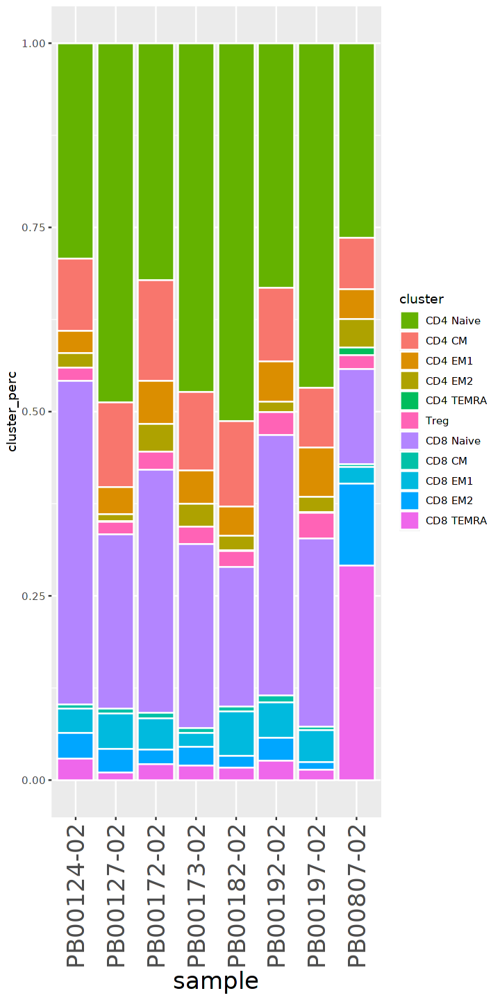

In [30]:
options(repr.plot.width = 6, repr.plot.height = 12)
ggplot(ped_percs_tall, aes(x = sample, y = cluster_perc, fill = cluster, label = round(cluster_perc,2))) + 
       geom_bar(stat = "identity", position = 'fill', colour = 'white') + 
       scale_fill_manual(values = c('#64B200','#F8766D','#DB8E00','#AEA200','#00BD5C','#FF63B6','#B385FF','#00C1A7','#00BADE','#00A6FF','#EF67EB')) +
       theme(axis.text.x = element_text(size = 20, angle = 90, hjust = 1, vjust = 0.5), axis.title.x = element_text(size = 20))

In [43]:
# Open a pdf file
pdf("/home/jupyter/Organized_Gating_Analysis/05_Figures/saved_figures/fig1c_pediatric_distribution.pdf", width = 6, height = 12) 
# 2. Create a plot
ggplot(ped_percs_tall, aes(x = sample, y = cluster_perc, fill = cluster, label = round(cluster_perc,2))) + 
       geom_bar(stat = "identity", position = 'fill', colour = 'white') + 
       scale_fill_manual(values = c('#64B200','#F8766D','#DB8E00','#AEA200','#00BD5C','#FF63B6','#B385FF','#00C1A7','#00BADE','#00A6FF','#EF67EB')) +
       theme(axis.text.x = element_text(size = 20, angle = 90, hjust = 1, vjust = 0.5), axis.title.x = element_text(size = 20))
# Close the pdf file
dev.off()

png 
  2

## Senior

In [31]:
sen_celltype <- celltype_df_func(split_sp_merge$Senior, 'gating_celltype', sort(trim_celltypes))

In [32]:
head(sen_celltype)

,sample,CD4 CM,CD4 EM1,CD4 EM2,CD4 Naive,CD4 TEMRA,CD8 CM,CD8 EM1,CD8 EM2,CD8 Naive,CD8 TEMRA,Treg
,<fct>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,PB00323-02,2900,315,367,4937,2,128,509,902,949,1042,188
2,PB00334-03,8005,2252,1075,8213,9,223,1343,780,1102,703,513
3,PB00353-03,4638,753,1429,6822,16,476,2242,2404,3591,598,401
4,PB00368-04,3130,936,2484,6984,153,170,924,3006,2490,1268,505
5,PB00377-03,6641,1341,625,14373,6,139,668,290,657,62,454
6,PB00545-02,5835,2009,1579,5949,11,189,1059,545,2443,270,532


In [33]:
rownames(sen_celltype) <- sen_celltype$sample
sen_celltype <- sen_celltype[,2:12]
colnames(sen_celltype) <- sort(trim_celltypes)
sen_celltype

,CD4 CM,CD4 EM1,CD4 EM2,CD4 Naive,CD4 TEMRA,CD8 CM,CD8 EM1,CD8 EM2,CD8 Naive,CD8 TEMRA,Treg
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
PB00323-02,2900,315,367,4937,2,128,509,902,949,1042,188
PB00334-03,8005,2252,1075,8213,9,223,1343,780,1102,703,513
PB00353-03,4638,753,1429,6822,16,476,2242,2404,3591,598,401
PB00368-04,3130,936,2484,6984,153,170,924,3006,2490,1268,505
PB00377-03,6641,1341,625,14373,6,139,668,290,657,62,454
PB00545-02,5835,2009,1579,5949,11,189,1059,545,2443,270,532
PB00593-04,1490,1405,1165,2821,36,184,725,728,762,271,280
PB00599-02,3638,1269,2385,3822,93,281,1710,4529,1048,2665,663


In [34]:
sen_sums <- rowSums(sen_celltype)

In [35]:
sen_perc <- sen_celltype / sen_sums
sen_perc

,CD4 CM,CD4 EM1,CD4 EM2,CD4 Naive,CD4 TEMRA,CD8 CM,CD8 EM1,CD8 EM2,CD8 Naive,CD8 TEMRA,Treg
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
PB00323-02,0.2369475,0.02573740,0.02998611,0.4033826,0.0001634120,0.010458371,0.04158837,0.07369883,0.07753901,0.085137675,0.01536073
PB00334-03,0.3305393,0.09298869,0.04438847,0.3391279,0.0003716244,0.009208027,0.05545462,0.03220745,0.04550334,0.029027996,0.02118259
PB00353-03,0.1984596,0.03222080,0.06114677,0.2919127,0.0006846384,0.020367993,0.09593496,0.10286692,0.15365854,0.025588361,0.01715875
PB00368-04,0.1419501,0.04244898,0.11265306,0.3167347,0.0069387755,0.007709751,0.04190476,0.13632653,0.11292517,0.057505669,0.02290249
PB00377-03,0.2629474,0.05309629,0.02474659,0.5690925,0.0002375673,0.005503643,0.02644916,0.01148242,0.02601362,0.002454862,0.01797593
PB00545-02,0.2857353,0.09837912,0.07732236,0.2913178,0.0005386612,0.009255178,0.05185838,0.02668821,0.11963175,0.013221684,0.02605161
PB00593-04,0.1510084,0.14239384,0.11807034,0.2859025,0.0036485254,0.018648019,0.07347725,0.07378129,0.07722712,0.027465288,0.02837742
PB00599-02,0.1645930,0.05741302,0.10790390,0.1729177,0.0042075736,0.012713206,0.07736506,0.20490431,0.04741438,0.120571868,0.02999593


In [36]:
sen_perc$sample <- rownames(sen_perc)
head(sen_perc)

,CD4 CM,CD4 EM1,CD4 EM2,CD4 Naive,CD4 TEMRA,CD8 CM,CD8 EM1,CD8 EM2,CD8 Naive,CD8 TEMRA,Treg,sample
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
PB00323-02,0.2369475,0.02573740,0.02998611,0.4033826,0.0001634120,0.010458371,0.04158837,0.07369883,0.07753901,0.085137675,0.01536073,PB00323-02
PB00334-03,0.3305393,0.09298869,0.04438847,0.3391279,0.0003716244,0.009208027,0.05545462,0.03220745,0.04550334,0.029027996,0.02118259,PB00334-03
PB00353-03,0.1984596,0.03222080,0.06114677,0.2919127,0.0006846384,0.020367993,0.09593496,0.10286692,0.15365854,0.025588361,0.01715875,PB00353-03
PB00368-04,0.1419501,0.04244898,0.11265306,0.3167347,0.0069387755,0.007709751,0.04190476,0.13632653,0.11292517,0.057505669,0.02290249,PB00368-04
PB00377-03,0.2629474,0.05309629,0.02474659,0.5690925,0.0002375673,0.005503643,0.02644916,0.01148242,0.02601362,0.002454862,0.01797593,PB00377-03
PB00545-02,0.2857353,0.09837912,0.07732236,0.2913178,0.0005386612,0.009255178,0.05185838,0.02668821,0.11963175,0.013221684,0.02605161,PB00545-02


In [37]:
col_order <- c('CD4 Naive','CD4 CM','CD4 EM1','CD4 EM2','CD4 TEMRA','Treg','CD8 Naive','CD8 CM','CD8 EM1','CD8 EM2','CD8 TEMRA','sample')
sen_perc2 <- sen_perc[,col_order]
head(sen_perc2)

,CD4 Naive,CD4 CM,CD4 EM1,CD4 EM2,CD4 TEMRA,Treg,CD8 Naive,CD8 CM,CD8 EM1,CD8 EM2,CD8 TEMRA,sample
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
PB00323-02,0.4033826,0.2369475,0.02573740,0.02998611,0.0001634120,0.01536073,0.07753901,0.010458371,0.04158837,0.07369883,0.085137675,PB00323-02
PB00334-03,0.3391279,0.3305393,0.09298869,0.04438847,0.0003716244,0.02118259,0.04550334,0.009208027,0.05545462,0.03220745,0.029027996,PB00334-03
PB00353-03,0.2919127,0.1984596,0.03222080,0.06114677,0.0006846384,0.01715875,0.15365854,0.020367993,0.09593496,0.10286692,0.025588361,PB00353-03
PB00368-04,0.3167347,0.1419501,0.04244898,0.11265306,0.0069387755,0.02290249,0.11292517,0.007709751,0.04190476,0.13632653,0.057505669,PB00368-04
PB00377-03,0.5690925,0.2629474,0.05309629,0.02474659,0.0002375673,0.01797593,0.02601362,0.005503643,0.02644916,0.01148242,0.002454862,PB00377-03
PB00545-02,0.2913178,0.2857353,0.09837912,0.07732236,0.0005386612,0.02605161,0.11963175,0.009255178,0.05185838,0.02668821,0.013221684,PB00545-02


In [38]:
library(tidyr)

In [39]:
sen_percs_tall <- gather(data = sen_perc2, key = cluster, value = cluster_perc, `CD4 Naive`:`CD8 TEMRA`, factor_key = TRUE)
head(sen_percs_tall)

,sample,cluster,cluster_perc
,<chr>,<fct>,<dbl>
1,PB00323-02,CD4 Naive,0.4033826
2,PB00334-03,CD4 Naive,0.3391279
3,PB00353-03,CD4 Naive,0.2919127
4,PB00368-04,CD4 Naive,0.3167347
5,PB00377-03,CD4 Naive,0.5690925
6,PB00545-02,CD4 Naive,0.2913178


### Plot

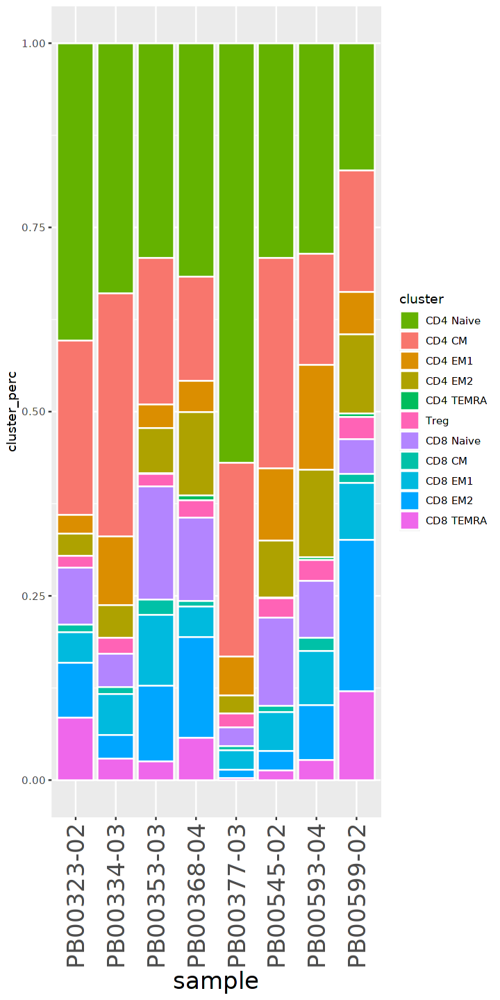

In [40]:
options(repr.plot.width = 6, repr.plot.height = 12)
ggplot(sen_percs_tall, aes(x = sample, y = cluster_perc, fill = cluster, label = round(cluster_perc,2))) + 
       geom_bar(stat = "identity", position = 'fill', colour = 'white') + 
       scale_fill_manual(values = c('#64B200','#F8766D','#DB8E00','#AEA200','#00BD5C','#FF63B6','#B385FF','#00C1A7','#00BADE','#00A6FF','#EF67EB')) +
       theme(axis.text.x = element_text(size = 20, angle = 90, hjust = 1, vjust = 0.5), axis.title.x = element_text(size = 20))

In [44]:
# Open a pdf file
pdf("/home/jupyter/Organized_Gating_Analysis/05_Figures/saved_figures/fig1c_senior_distribution.pdf", width = 6, height = 12) 
# 2. Create a plot
ggplot(sen_percs_tall, aes(x = sample, y = cluster_perc, fill = cluster, label = round(cluster_perc,2))) + 
       geom_bar(stat = "identity", position = 'fill', colour = 'white') + 
       scale_fill_manual(values = c('#64B200','#F8766D','#DB8E00','#AEA200','#00BD5C','#FF63B6','#B385FF','#00C1A7','#00BADE','#00A6FF','#EF67EB')) +
       theme(axis.text.x = element_text(size = 20, angle = 90, hjust = 1, vjust = 0.5), axis.title.x = element_text(size = 20))
# Close the pdf file
dev.off()

png 
  2

# Figure 1b & 1c

In [51]:
sp_merge <- readRDS(file = '/home/jupyter/Organized_Gating_Analysis/Seurat_Objects/sp_merge_gating_celltype_updated.rds')

In [52]:
sp_merge <- SetIdent(sp_merge, value = 'gating_celltype')
sp_merge <- subset(sp_merge, idents = c('CD4 Unk','CD8 Unk'), invert = TRUE)

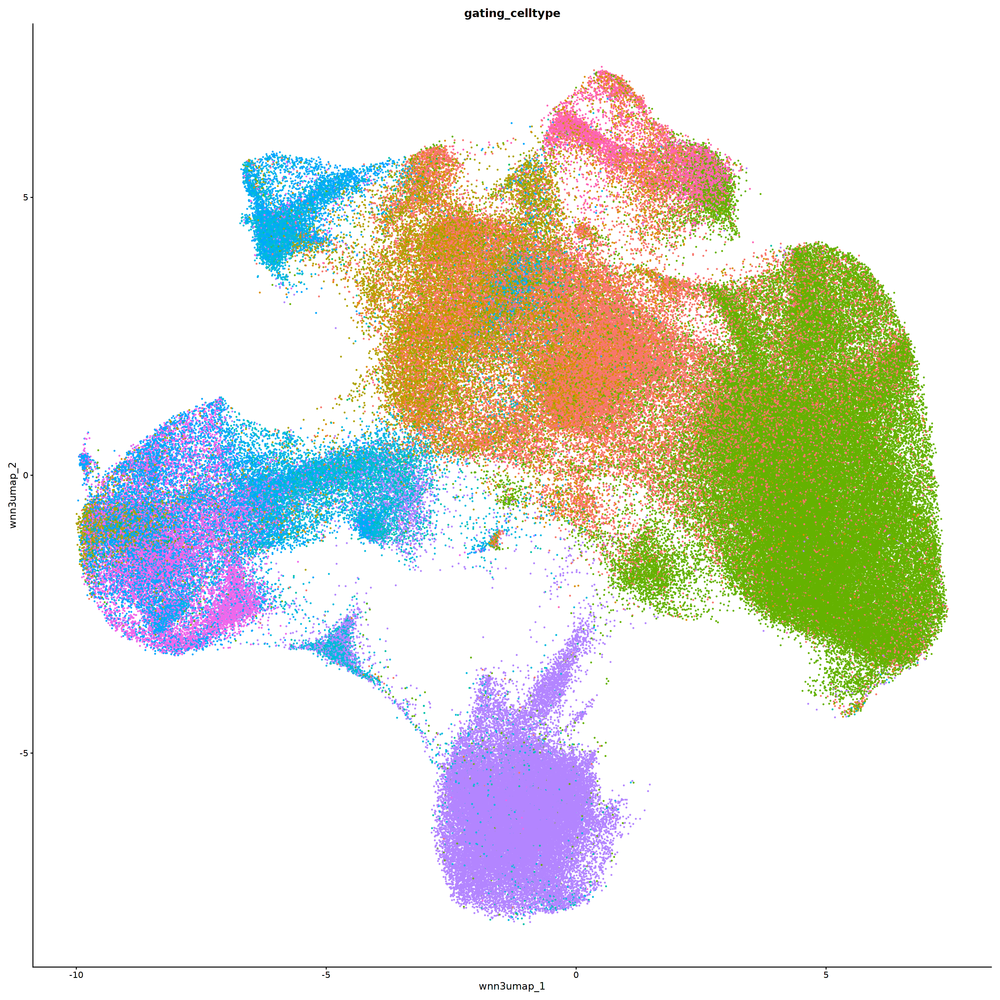

In [53]:
options(repr.plot.width = 20, repr.plot.height = 20)
DimPlot(sp_merge, reduction = 'wnn.3.umap', group.by = 'gating_celltype', raster = FALSE, shuffle = TRUE, pt.size = 0.25) & NoLegend()

In [54]:
# Open a pdf file
pdf("/home/jupyter/Organized_Gating_Analysis/05_Figures/saved_figures/fig2_wnn_umap.pdf", width = 20, height = 20) 
# 2. Create a plot
DimPlot(sp_merge, reduction = 'wnn.3.umap', group.by = 'gating_celltype', raster = FALSE, shuffle = TRUE, pt.size = 0.25) & NoLegend()
# Close the pdf file
dev.off()

png 
  2

In [55]:
wnn_df <- as.data.frame(sp_merge@reductions$wnn.3.umap@cell.embeddings)
wnn_df$gating_celltype <- sp_merge$gating_celltype
head(wnn_df)

,wnn3umap_1,wnn3umap_2,gating_celltype
,<dbl>,<dbl>,<chr>
970c3f98e40811eba89d42010a19c839,-0.8019088,-5.895669,CD8 Naive
971b0bd6e40811eba89d42010a19c839,0.3050871,-5.484430,CD8 Naive
97267fdee40811eba89d42010a19c839,-0.3288510,-5.762752,CD8 Naive
9728e26ae40811eba89d42010a19c839,-0.7747660,-7.751556,CD8 Naive
97475100e40811eba89d42010a19c839,-0.3597772,-6.296741,CD8 Naive
97789738e40811eba89d42010a19c839,-1.9845226,-6.573844,CD8 Naive


## Cell type Density Plot

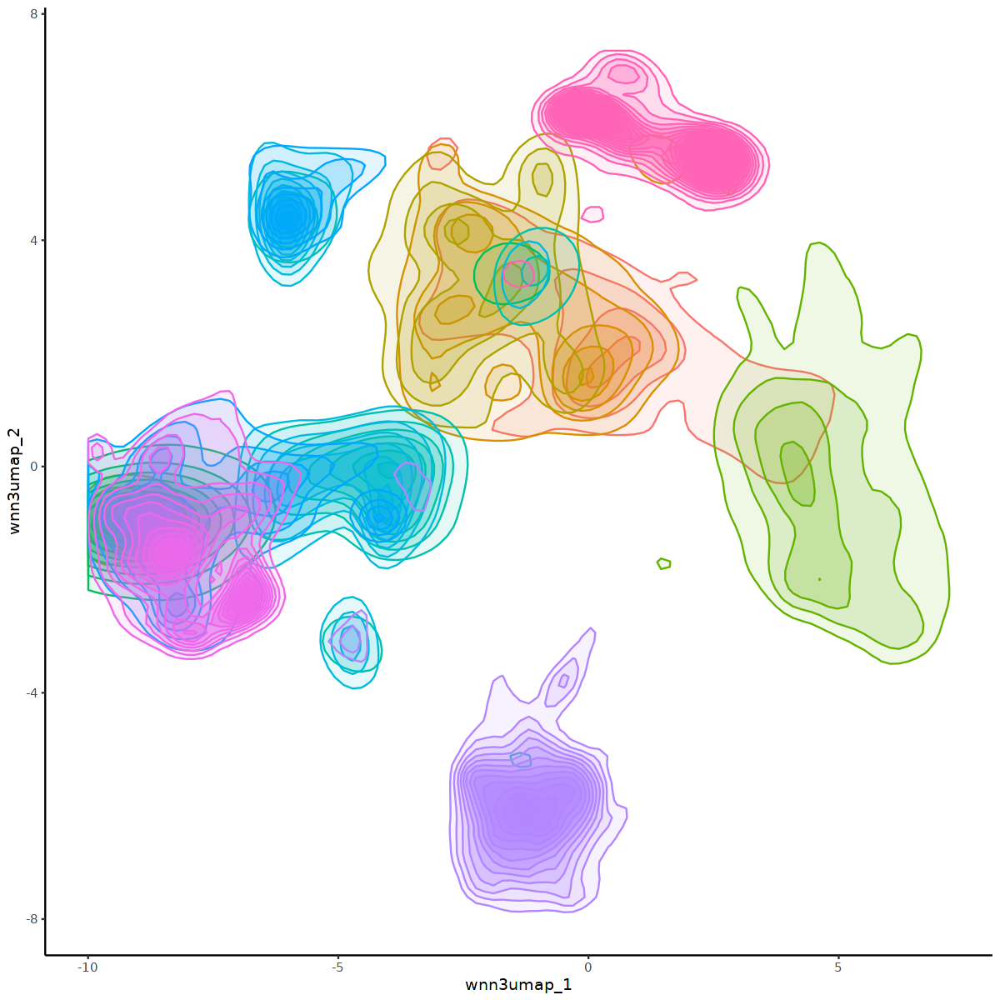

In [58]:
options(repr.plot.width = 10, repr.plot.height = 10)
ggplot(wnn_df, aes(x = wnn3umap_1, y = wnn3umap_2, color = gating_celltype)) + #geom_point(shape = ".") +
stat_density_2d(geom = 'polygon', aes(alpha = ..level.., fill = gating_celltype), bins = 25) +
theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(), panel.background = element_blank(),axis.line = element_line(colour = "black"),
      legend.position = 'none') 

In [59]:
# Open a pdf file
pdf("/home/jupyter/Organized_Gating_Analysis/05_Figures/saved_figures/fig2_wnn_density_umap.pdf", width = 10, height = 10) 
# 2. Create a plot
ggplot(wnn_df, aes(x = wnn3umap_1, y = wnn3umap_2, color = gating_celltype)) + #geom_point(shape = ".") +
stat_density_2d(geom = 'polygon', aes(alpha = ..level.., fill = gating_celltype), bins = 25) +
theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(), panel.background = element_blank(),axis.line = element_line(colour = "black"),
      legend.position = 'none') 
# Close the pdf file
dev.off()

png 
  2

In [11]:
table(sp_merge$CMV)
table(sp_merge$pediatric_senior)


Positive Negative 
  134075   166343 


Pediatric    Senior 
   120551    179867 

In [12]:
# sp_merge <- SetIdent(sp_merge, value = 'gating_celltype')
# sp_merge <- subset(sp_merge, idents = c('CD4 Unk','CD8 Unk'), invert = TRUE)

In [ ]:
sp_merge <- SetIdent(sp_merge, value = 'pediatric_senior')
sp_merge <- subset(sp_merge, downsample = 100000)
table(sp_merge$pediatric_senior)

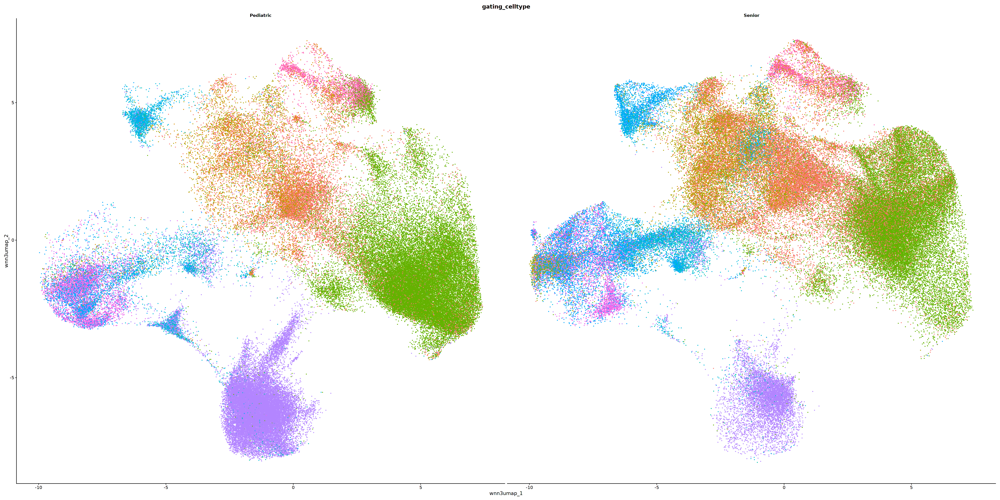

In [14]:
options(repr.plot.width = 40, repr.plot.height = 20)
DimPlot(sp_merge, reduction = 'wnn.3.umap', group.by = 'gating_celltype', raster = FALSE, shuffle = TRUE, split.by = 'pediatric_senior', pt.size = 0.25) & NoLegend()

In [15]:
# Open a pdf file
pdf("/home/jupyter/Organized_Gating_Analysis/05_Figures/saved_figures/fig1d_wnn_split_age_umap.pdf", width = 40, height = 20) 
# 2. Create a plot
DimPlot(sp_merge, reduction = 'wnn.3.umap', group.by = 'gating_celltype', raster = FALSE, shuffle = TRUE, split.by = 'pediatric_senior', pt.size = 0.25) & NoLegend()
# Close the pdf file
dev.off()

png 
  2

In [60]:
quiet_library(MASS)

In [61]:
sp_merge <- readRDS(file = '/home/jupyter/Organized_Gating_Analysis/Seurat_Objects/sp_merge_gating_celltype_updated.rds')

In [62]:
sp_merge <- SetIdent(sp_merge, value = 'gating_celltype')
sp_merge <- subset(sp_merge, idents = c('CD4 Unk','CD8 Unk'), invert = TRUE)

In [63]:
sp_merge <- SetIdent(sp_merge, value = 'pediatric_senior')
sp_merge <- subset(sp_merge, downsample = 100000)
table(sp_merge$pediatric_senior)


Pediatric    Senior 
   100000    100000 

In [64]:
peds <- subset(sp_merge, idents = 'Pediatric')
sens <- subset(sp_merge, idents = 'Senior')

In [65]:
ped_umap <- as.data.frame(peds@reductions$wnn.3.umap@cell.embeddings)
sen_umap <- as.data.frame(sens@reductions$wnn.3.umap@cell.embeddings)

In [66]:
ped_density <- kde2d(x = ped_umap$wnn3umap_1, y = ped_umap$wnn3umap_2, n = 500)
sen_density <- kde2d(x = sen_umap$wnn3umap_1, y = sen_umap$wnn3umap_2, n = 500)

In [67]:
diff_pedsen <- ped_density
diff_pedsen$z <- sen_density$z - ped_density$z

In [68]:
rownames(diff_pedsen$z) = diff_pedsen$x
colnames(diff_pedsen$z) = diff_pedsen$y

In [69]:
diff_pedsen.m = melt(diff_pedsen$z, id.var=rownames(diff_pedsen))
names(diff_pedsen.m) = c("wnn3umap_1","wnn3umap_2","z")

Warning message in melt(diff_pedsen$z, id.var = rownames(diff_pedsen)):
“The melt generic in data.table has been passed a matrix and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(diff_pedsen$z). In the next version, this warning will become an error.”


In [70]:
min(diff_pedsen.m$z)
max(diff_pedsen.m$z)

[1] -0.05084858

[1] 0.03345291

In [71]:
library(scales)

## Age Density Plot

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


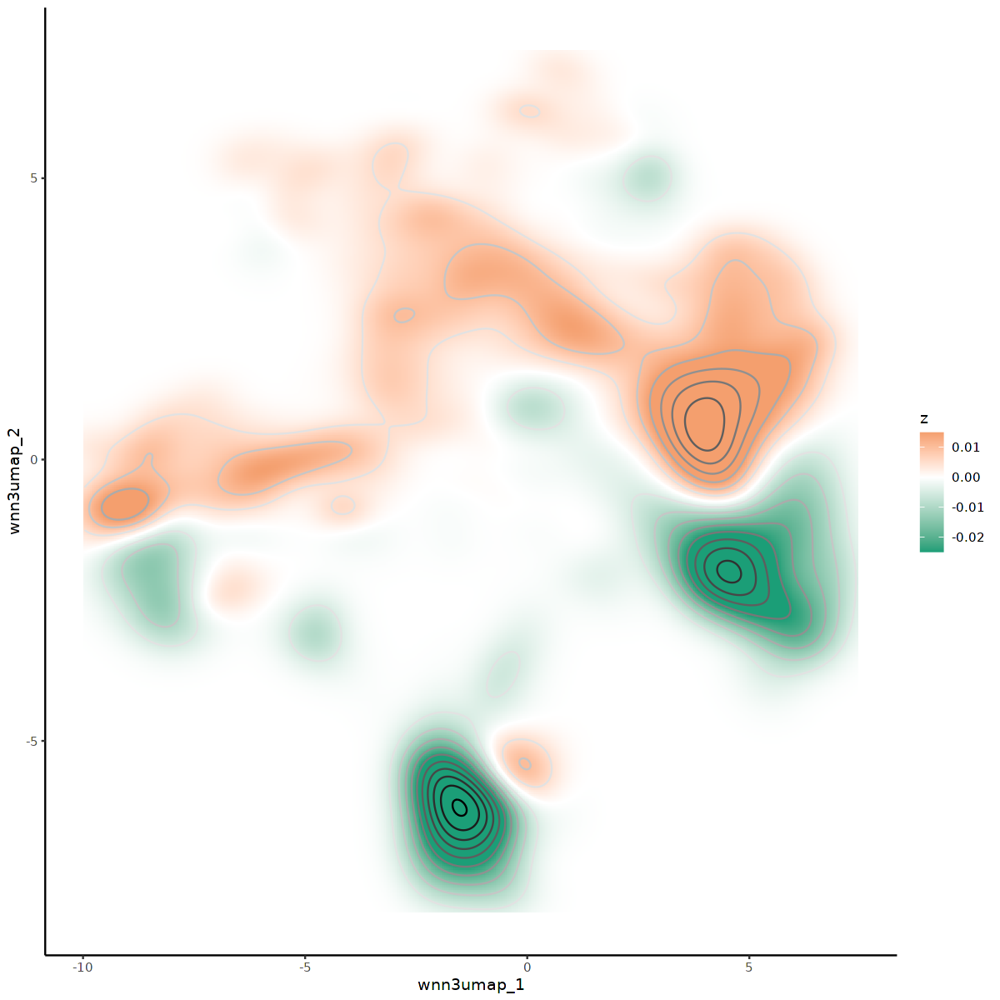

In [72]:
options(repr.plot.width = 10, repr.plot.height = 10)
ggplot(diff_pedsen.m, aes(wnn3umap_1, wnn3umap_2, z=z, fill=z)) +
  geom_tile() +
  stat_contour(aes(colour=..level..), binwidth=0.005) +
  scale_fill_gradient2(low='#1b9e77',mid="white", high='#d95f02', midpoint=0, limits = c(-0.025,0.015), oob=squish) +
  scale_colour_gradient2(low='black', mid="white", high='black', midpoint=0) +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(), panel.background = element_blank(),axis.line = element_line(colour = "black")) +
  #coord_cartesian(xlim=xrng, ylim=yrng) +
  guides(colour=FALSE)

In [73]:
# Open a pdf file
pdf("/home/jupyter/Organized_Gating_Analysis/05_Figures/saved_figures/fig1d_wnn_age_density_umap.pdf", width = 10, height = 10) 
# 2. Create a plot
ggplot(diff_pedsen.m, aes(wnn3umap_1, wnn3umap_2, z=z, fill=z)) +
  geom_tile() +
  stat_contour(aes(colour=..level..), binwidth=0.005) +
  scale_fill_gradient2(low='#1b9e77',mid="white", high='#d95f02', midpoint=0, limits = c(-0.025,0.015), oob=squish) +
  scale_colour_gradient2(low='black', mid="white", high='black', midpoint=0) +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(), panel.background = element_blank(),axis.line = element_line(colour = "black")) +
  #coord_cartesian(xlim=xrng, ylim=yrng) +
  guides(colour=FALSE)
# Close the pdf file
dev.off()

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


png 
  2

In [74]:
sp_merge <- readRDS(file = '/home/jupyter/Organized_Gating_Analysis/Seurat_Objects/sp_merge_gating_celltype_updated.rds')

In [75]:
sp_merge <- SetIdent(sp_merge, value = 'gating_celltype')
sp_merge <- subset(sp_merge, idents = c('CD4 Unk','CD8 Unk'), invert = TRUE)

In [76]:
sp_merge <- SetIdent(sp_merge, value = 'CMV')
sp_merge <- subset(sp_merge, downsample = 100000)
table(sp_merge$CMV)


Positive Negative 
  100000   100000 

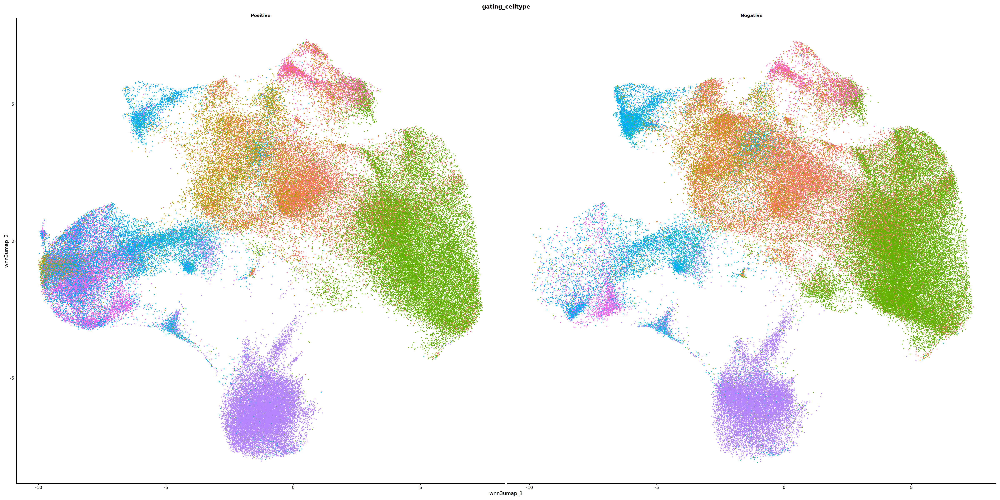

In [77]:
options(repr.plot.width = 40, repr.plot.height = 20)
DimPlot(sp_merge, reduction = 'wnn.3.umap', group.by = 'gating_celltype', raster = FALSE, shuffle = TRUE, split.by = 'CMV', pt.size = 0.25) & NoLegend()

In [78]:
# Open a pdf file
pdf("/home/jupyter/Organized_Gating_Analysis/05_Figures/saved_figures/fig1d_wnn_split_cmv_umap.pdf", width = 40, height = 20) 
# 2. Create a plot
DimPlot(sp_merge, reduction = 'wnn.3.umap', group.by = 'gating_celltype', raster = FALSE, shuffle = TRUE, split.by = 'CMV', pt.size = 0.25) & NoLegend()
# Close the pdf file
dev.off()

png 
  2

In [79]:
pos <- subset(sp_merge, idents = 'Positive')
neg <- subset(sp_merge, idents = 'Negative')

In [80]:
pos_umap <- as.data.frame(pos@reductions$wnn.3.umap@cell.embeddings)
neg_umap <- as.data.frame(neg@reductions$wnn.3.umap@cell.embeddings)

In [81]:
pos_density <- kde2d(x = pos_umap$wnn3umap_1, y = pos_umap$wnn3umap_2, n = 250)
neg_density <- kde2d(x = neg_umap$wnn3umap_1, y = neg_umap$wnn3umap_2, n = 250)

In [82]:
diff_cmv <- pos_density
diff_cmv$z <- neg_density$z - pos_density$z

In [83]:
rownames(diff_cmv$z) = diff_cmv$x
colnames(diff_cmv$z) = diff_cmv$y

In [84]:
diff_cmv.m = melt(diff_cmv$z, id.var=rownames(diff_cmv))
names(diff_cmv.m) = c("wnn3umap_1","wnn3umap_2","z")

Warning message in melt(diff_cmv$z, id.var = rownames(diff_cmv)):
“The melt generic in data.table has been passed a matrix and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(diff_cmv$z). In the next version, this warning will become an error.”


In [85]:
head(diff_cmv.m)

,wnn3umap_1,wnn3umap_2,z
,<dbl>,<dbl>,<dbl>
1,-9.996340,-8.030759,-9.904723e-53
2,-9.926395,-8.030759,-1.956990e-51
3,-9.856450,-8.030759,-1.654716e-50
4,-9.786505,-8.030759,-1.220834e-49
5,-9.716560,-8.030759,-8.599714e-49
6,-9.646615,-8.030759,-5.905134e-48


In [86]:
min(diff_cmv.m$z)
max(diff_cmv.m$z)

[1] -0.02960266

[1] 0.01812693

## CMV Density Plot

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


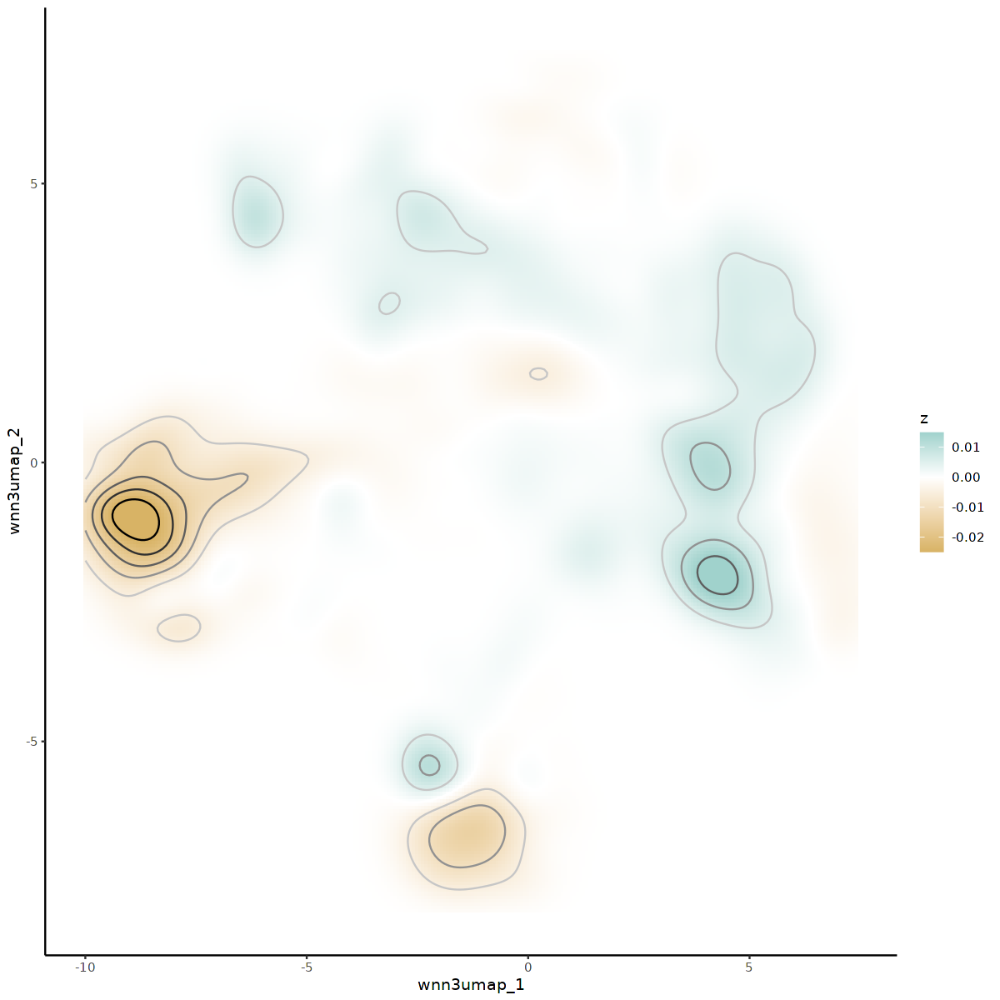

In [87]:
options(repr.plot.width = 10, repr.plot.height = 10)
ggplot(diff_cmv.m, aes(wnn3umap_1, wnn3umap_2, z=z, fill=z)) +
  geom_tile() +
  stat_contour(aes(colour=..level..), binwidth=0.005) +
  scale_fill_gradient2(low='#d8b365',mid="white", high='#5ab4ac', midpoint=0, limits = c(-0.025,0.015), oob=squish) +
  scale_colour_gradient2(low='black', mid="white", high='black', midpoint=0) + 
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(), panel.background = element_blank(),axis.line = element_line(colour = "black")) +
  #coord_cartesian(xlim=xrng, ylim=yrng)
  guides(colour=FALSE)

In [88]:
# Open a pdf file
pdf("/home/jupyter/Organized_Gating_Analysis/05_Figures/saved_figures/fig1d_wnn_cmv_density_umap.pdf", width = 10, height = 10) 
# 2. Create a plot
ggplot(diff_cmv.m, aes(wnn3umap_1, wnn3umap_2, z=z, fill=z)) +
  geom_tile() +
  stat_contour(aes(colour=..level..), binwidth=0.005) +
  scale_fill_gradient2(low='#d8b365',mid="white", high='#5ab4ac', midpoint=0, limits = c(-0.025,0.015), oob=squish) +
  scale_colour_gradient2(low='black', mid="white", high='black', midpoint=0) + 
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank(), panel.background = element_blank(),axis.line = element_line(colour = "black")) +
  #coord_cartesian(xlim=xrng, ylim=yrng)
  guides(colour=FALSE)
# Close the pdf file
dev.off()

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


png 
  2